In [4]:
# open the generated synthetic data file and read it as a python dictionary called data

import json

file = open('synthetic_dataset_with_time.txt', 'r')
text = file.read()
data = json.loads(text)


In [5]:
import emip_toolkit as EMTK

# find areas of interest (AOIs) once again
image_path = "./"
image = "synthetic_text.png"
aoi = EMTK.find_aoi(image, image_path, level="sub-line")


# add tokens to AOIs 
file_path = "./"
aois_with_tokens = EMTK.add_tokens_to_AOIs(file_path, image.split(".")[0]+".txt", aoi)
aois_with_tokens.head()


import correction

# find the y coordinate of each line in the text
line_ys = correction.find_lines_Y(aoi)

In [6]:
import numpy as np
import drift_algorithms as algo
from tqdm import tqdm

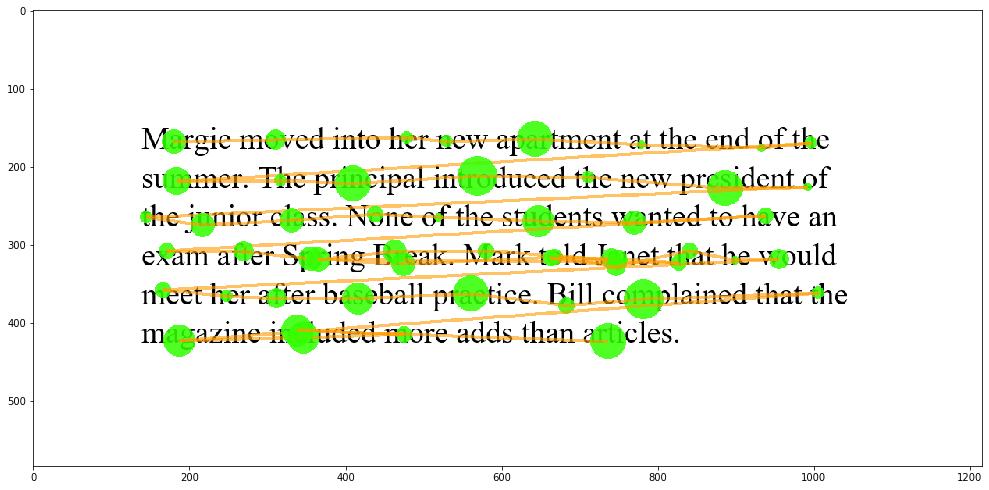

In [7]:
# draw original correct fixations

correction.draw_fixation('synthetic_text.png', data['robot1'].copy())

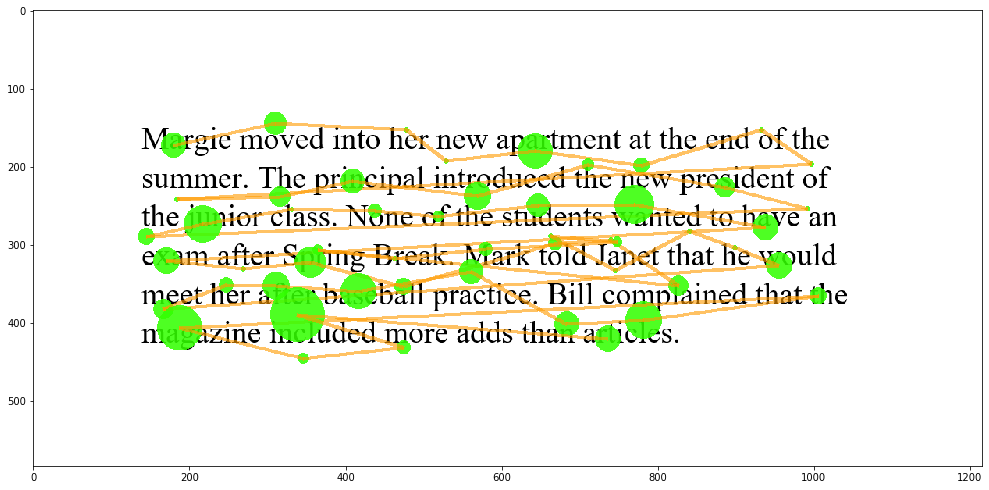

In [8]:
# generate noise over the correct trial

error_test = correction.error_noise(1, 30, 1, data['robot1'].copy())

# draw the trial with added error
correction.draw_fixation('synthetic_text.png', error_test)

1.0


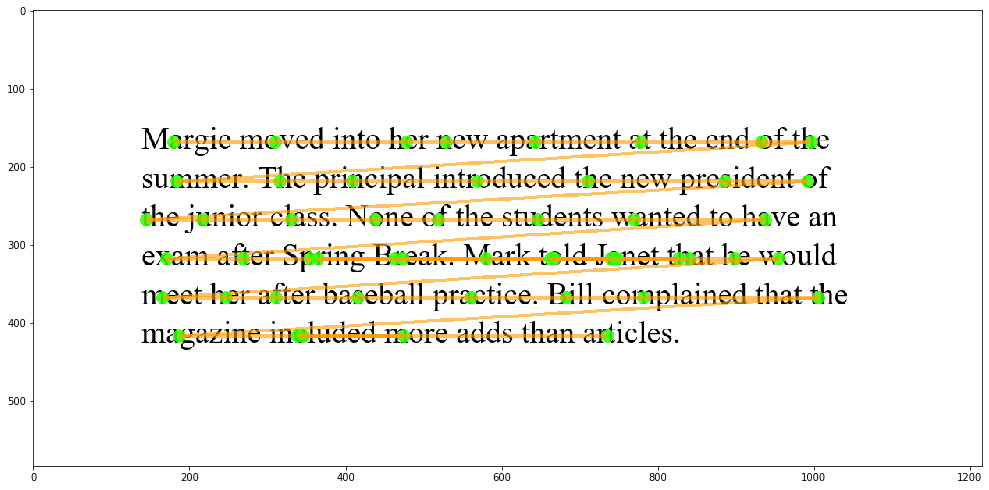

In [9]:
# find the center of each word, we need this for warp algorithm
word_centers = correction.find_word_centers(aoi)
word_centers = np.array(word_centers.copy(), dtype=int)

# warp correction
np_array = np.array(error_test.copy(), dtype=int)
durations = np.delete(np_array, 0, 1)
durations = np.delete(durations, 0, 1)
np_array = np.delete(np_array, 2, 1)

# run warp
warp_correction = algo.warp(np_array, word_centers)

# this is a cool function that checks the quality of the correction
percentage, match_list = correction.correction_quality(aoi, data['robot1'].copy(), warp_correction)
print(percentage)

# this is a cool function that draws the correction in red if the algorithm made a mistake
correction.draw_correction('synthetic_text.png', warp_correction, match_list)

This concludes the example I wanted to show you of running an error generator, then correcting the data, then seeing how well the correction algorithm did.  You will need to repeat the same concept for a bunch of algorithms in the next section.

# Comparing algorithms with Noise error:

In this example, I show you one type of erro "Noise" you will implement all 5 types and add skipping to your assessment.  Also, the code below runs only 4 algorithms, you will add the remaining 6 algorithms to this assessment for each type of error. 

  0%|          | 0/100 [00:00<?, ?it/s]

robot: 0     error probability: 0
robot: 0     error probability: 1
robot: 0     error probability: 2
robot: 0     error probability: 3
robot: 0     error probability: 4
robot: 0     error probability: 5
robot: 0     error probability: 6
robot: 0     error probability: 7
robot: 0     error probability: 8
robot: 0     error probability: 9


  1%|          | 1/100 [00:47<1:18:41, 47.69s/it]

robot: 0     error probability: 10


  3%|▎         | 3/100 [01:58<1:01:37, 38.12s/it]

robot: 3     error probability: 0
robot: 3     error probability: 1
robot: 3     error probability: 2
robot: 3     error probability: 3
robot: 3     error probability: 4
robot: 3     error probability: 5
robot: 3     error probability: 6
robot: 3     error probability: 7
robot: 3     error probability: 8


/Users/tamsinrogers/Desktop/CS421/project 1/CS421-project1/correction.py:277: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(17, 15))


robot: 3     error probability: 9


  4%|▍         | 4/100 [02:46<1:06:53, 41.81s/it]

robot: 3     error probability: 10
robot: 4     error probability: 0
robot: 4     error probability: 1
robot: 4     error probability: 2
robot: 4     error probability: 3
robot: 4     error probability: 4
robot: 4     error probability: 5
robot: 4     error probability: 6
robot: 4     error probability: 7
robot: 4     error probability: 8
robot: 4     error probability: 9


  5%|▌         | 5/100 [03:25<1:04:44, 40.89s/it]

robot: 4     error probability: 10
robot: 5     error probability: 0
robot: 5     error probability: 1
robot: 5     error probability: 2
robot: 5     error probability: 3
robot: 5     error probability: 4
robot: 5     error probability: 5
robot: 5     error probability: 6
robot: 5     error probability: 7
robot: 5     error probability: 8
robot: 5     error probability: 9


  6%|▌         | 6/100 [04:06<1:03:57, 40.83s/it]

robot: 5     error probability: 10
robot: 6     error probability: 0
robot: 6     error probability: 1
robot: 6     error probability: 2
robot: 6     error probability: 3
robot: 6     error probability: 4
robot: 6     error probability: 5
robot: 6     error probability: 6
robot: 6     error probability: 7
robot: 6     error probability: 8
robot: 6     error probability: 9


  7%|▋         | 7/100 [04:57<1:08:40, 44.31s/it]

robot: 6     error probability: 10


  8%|▊         | 8/100 [05:33<1:03:50, 41.64s/it]

robot: 8     error probability: 0
robot: 8     error probability: 1
robot: 8     error probability: 2
robot: 8     error probability: 3
robot: 8     error probability: 4
robot: 8     error probability: 5
robot: 8     error probability: 6
robot: 8     error probability: 7
robot: 8     error probability: 8
robot: 8     error probability: 9


  9%|▉         | 9/100 [06:14<1:02:40, 41.32s/it]

robot: 8     error probability: 10


 10%|█         | 10/100 [06:53<1:01:09, 40.77s/it]

robot: 10     error probability: 0
robot: 10     error probability: 1
robot: 10     error probability: 2
robot: 10     error probability: 3
robot: 10     error probability: 4
robot: 10     error probability: 5
robot: 10     error probability: 6
robot: 10     error probability: 7
robot: 10     error probability: 8
robot: 10     error probability: 9


 11%|█         | 11/100 [07:51<1:08:03, 45.88s/it]

robot: 10     error probability: 10


 13%|█▎        | 13/100 [1:08:53<27:16:09, 1128.39s/it]

robot: 13     error probability: 0
robot: 13     error probability: 1
robot: 13     error probability: 2
robot: 13     error probability: 3
robot: 13     error probability: 4
robot: 13     error probability: 5
robot: 13     error probability: 6
robot: 13     error probability: 7
robot: 13     error probability: 8
robot: 13     error probability: 9


 14%|█▍        | 14/100 [1:38:58<31:50:19, 1332.78s/it]

robot: 13     error probability: 10
robot: 14     error probability: 0
robot: 14     error probability: 1
robot: 14     error probability: 2
robot: 14     error probability: 3
robot: 14     error probability: 4
robot: 14     error probability: 5
robot: 14     error probability: 6
robot: 14     error probability: 7
robot: 14     error probability: 8
robot: 14     error probability: 9


 15%|█▌        | 15/100 [1:39:50<22:21:17, 946.80s/it] 

robot: 14     error probability: 10
robot: 15     error probability: 0
robot: 15     error probability: 1
robot: 15     error probability: 2
robot: 15     error probability: 3
robot: 15     error probability: 4
robot: 15     error probability: 5
robot: 15     error probability: 6
robot: 15     error probability: 7
robot: 15     error probability: 8
robot: 15     error probability: 9


 16%|█▌        | 16/100 [1:40:30<15:43:05, 673.63s/it]

robot: 15     error probability: 10
robot: 16     error probability: 0
robot: 16     error probability: 1
robot: 16     error probability: 2
robot: 16     error probability: 3
robot: 16     error probability: 4
robot: 16     error probability: 5
robot: 16     error probability: 6
robot: 16     error probability: 7
robot: 16     error probability: 8
robot: 16     error probability: 9


 17%|█▋        | 17/100 [1:41:21<11:12:54, 486.44s/it]

robot: 16     error probability: 10
robot: 17     error probability: 0
robot: 17     error probability: 1
robot: 17     error probability: 2
robot: 17     error probability: 3
robot: 17     error probability: 4
robot: 17     error probability: 5
robot: 17     error probability: 6
robot: 17     error probability: 7
robot: 17     error probability: 8
robot: 17     error probability: 9


 18%|█▊        | 18/100 [1:42:00<8:01:05, 352.02s/it] 

robot: 17     error probability: 10
robot: 18     error probability: 0
robot: 18     error probability: 1
robot: 18     error probability: 2
robot: 18     error probability: 3
robot: 18     error probability: 4
robot: 18     error probability: 5
robot: 18     error probability: 6
robot: 18     error probability: 7
robot: 18     error probability: 8
robot: 18     error probability: 9


 19%|█▉        | 19/100 [1:42:38<5:48:05, 257.85s/it]

robot: 18     error probability: 10


 20%|██        | 20/100 [1:43:08<4:12:35, 189.44s/it]

robot: 20     error probability: 0
robot: 20     error probability: 1
robot: 20     error probability: 2
robot: 20     error probability: 3
robot: 20     error probability: 4
robot: 20     error probability: 5
robot: 20     error probability: 6
robot: 20     error probability: 7
robot: 20     error probability: 8
robot: 20     error probability: 9


 21%|██        | 21/100 [1:43:43<3:08:09, 142.91s/it]

robot: 20     error probability: 10


 22%|██▏       | 22/100 [1:44:14<2:22:02, 109.26s/it]

robot: 22     error probability: 0
robot: 22     error probability: 1
robot: 22     error probability: 2
robot: 22     error probability: 3
robot: 22     error probability: 4
robot: 22     error probability: 5
robot: 22     error probability: 6
robot: 22     error probability: 7
robot: 22     error probability: 8
robot: 22     error probability: 9


 23%|██▎       | 23/100 [1:44:55<1:53:55, 88.78s/it] 

robot: 22     error probability: 10
robot: 23     error probability: 0
robot: 23     error probability: 1
robot: 23     error probability: 2
robot: 23     error probability: 3
robot: 23     error probability: 4
robot: 23     error probability: 5
robot: 23     error probability: 6
robot: 23     error probability: 7
robot: 23     error probability: 8
robot: 23     error probability: 9


 24%|██▍       | 24/100 [1:45:30<1:32:20, 72.90s/it]

robot: 23     error probability: 10
robot: 24     error probability: 0
robot: 24     error probability: 1
robot: 24     error probability: 2
robot: 24     error probability: 3
robot: 24     error probability: 4
robot: 24     error probability: 5
robot: 24     error probability: 6
robot: 24     error probability: 7
robot: 24     error probability: 8
robot: 24     error probability: 9


 25%|██▌       | 25/100 [1:46:04<1:16:14, 60.99s/it]

robot: 24     error probability: 10


 26%|██▌       | 26/100 [1:46:35<1:04:09, 52.02s/it]

robot: 26     error probability: 0
robot: 26     error probability: 1
robot: 26     error probability: 2
robot: 26     error probability: 3
robot: 26     error probability: 4
robot: 26     error probability: 5
robot: 26     error probability: 6
robot: 26     error probability: 7
robot: 26     error probability: 8
robot: 26     error probability: 9


 27%|██▋       | 27/100 [1:47:22<1:01:36, 50.64s/it]

robot: 26     error probability: 10
robot: 27     error probability: 0
robot: 27     error probability: 1
robot: 27     error probability: 2
robot: 27     error probability: 3
robot: 27     error probability: 4
robot: 27     error probability: 5
robot: 27     error probability: 6
robot: 27     error probability: 7
robot: 27     error probability: 8
robot: 27     error probability: 9


 28%|██▊       | 28/100 [1:48:04<57:32, 47.95s/it]  

robot: 27     error probability: 10


 31%|███       | 31/100 [1:49:38<43:12, 37.58s/it]

robot: 31     error probability: 0
robot: 31     error probability: 1
robot: 31     error probability: 2
robot: 31     error probability: 3
robot: 31     error probability: 4
robot: 31     error probability: 5
robot: 31     error probability: 6
robot: 31     error probability: 7
robot: 31     error probability: 8
robot: 31     error probability: 9


 32%|███▏      | 32/100 [1:50:29<47:10, 41.63s/it]

robot: 31     error probability: 10
robot: 32     error probability: 0
robot: 32     error probability: 1
robot: 32     error probability: 2
robot: 32     error probability: 3
robot: 32     error probability: 4
robot: 32     error probability: 5
robot: 32     error probability: 6
robot: 32     error probability: 7
robot: 32     error probability: 8
robot: 32     error probability: 9


 33%|███▎      | 33/100 [1:51:06<44:39, 39.99s/it]

robot: 32     error probability: 10


 34%|███▍      | 34/100 [1:51:38<41:36, 37.82s/it]

robot: 34     error probability: 0
robot: 34     error probability: 1
robot: 34     error probability: 2
robot: 34     error probability: 3
robot: 34     error probability: 4
robot: 34     error probability: 5
robot: 34     error probability: 6
robot: 34     error probability: 7
robot: 34     error probability: 8
robot: 34     error probability: 9


 35%|███▌      | 35/100 [1:52:19<41:57, 38.72s/it]

robot: 34     error probability: 10
robot: 35     error probability: 0
robot: 35     error probability: 1
robot: 35     error probability: 2
robot: 35     error probability: 3
robot: 35     error probability: 4
robot: 35     error probability: 5
robot: 35     error probability: 6
robot: 35     error probability: 7
robot: 35     error probability: 8
robot: 35     error probability: 9


 36%|███▌      | 36/100 [1:53:11<45:34, 42.72s/it]

robot: 35     error probability: 10
robot: 36     error probability: 0
robot: 36     error probability: 1
robot: 36     error probability: 2
robot: 36     error probability: 3
robot: 36     error probability: 4
robot: 36     error probability: 5
robot: 36     error probability: 6
robot: 36     error probability: 7
robot: 36     error probability: 8
robot: 36     error probability: 9


 37%|███▋      | 37/100 [1:53:54<44:46, 42.64s/it]

robot: 36     error probability: 10
robot: 37     error probability: 0
robot: 37     error probability: 1
robot: 37     error probability: 2
robot: 37     error probability: 3
robot: 37     error probability: 4
robot: 37     error probability: 5
robot: 37     error probability: 6
robot: 37     error probability: 7
robot: 37     error probability: 8
robot: 37     error probability: 9


 38%|███▊      | 38/100 [1:54:38<44:31, 43.09s/it]

robot: 37     error probability: 10
robot: 38     error probability: 0
robot: 38     error probability: 1
robot: 38     error probability: 2
robot: 38     error probability: 3
robot: 38     error probability: 4
robot: 38     error probability: 5
robot: 38     error probability: 6
robot: 38     error probability: 7
robot: 38     error probability: 8
robot: 38     error probability: 9


 39%|███▉      | 39/100 [2:15:46<6:57:27, 410.61s/it]

robot: 38     error probability: 10
robot: 39     error probability: 0
robot: 39     error probability: 1
robot: 39     error probability: 2
robot: 39     error probability: 3
robot: 39     error probability: 4
robot: 39     error probability: 5
robot: 39     error probability: 6
robot: 39     error probability: 7
robot: 39     error probability: 8
robot: 39     error probability: 9


 40%|████      | 40/100 [2:41:10<12:24:32, 744.54s/it]

robot: 39     error probability: 10
robot: 40     error probability: 0
robot: 40     error probability: 1
robot: 40     error probability: 2
robot: 40     error probability: 3
robot: 40     error probability: 4
robot: 40     error probability: 5
robot: 40     error probability: 6
robot: 40     error probability: 7
robot: 40     error probability: 8
robot: 40     error probability: 9


 41%|████      | 41/100 [2:42:21<8:53:31, 542.57s/it] 

robot: 40     error probability: 10


 44%|████▍     | 44/100 [2:46:09<3:39:37, 235.31s/it]

robot: 44     error probability: 0
robot: 44     error probability: 1
robot: 44     error probability: 2
robot: 44     error probability: 3
robot: 44     error probability: 4
robot: 44     error probability: 5
robot: 44     error probability: 6
robot: 44     error probability: 7
robot: 44     error probability: 8
robot: 44     error probability: 9


 45%|████▌     | 45/100 [2:47:22<2:51:02, 186.59s/it]

robot: 44     error probability: 10
robot: 45     error probability: 0
robot: 45     error probability: 1
robot: 45     error probability: 2
robot: 45     error probability: 3
robot: 45     error probability: 4
robot: 45     error probability: 5
robot: 45     error probability: 6
robot: 45     error probability: 7
robot: 45     error probability: 8
robot: 45     error probability: 9


 46%|████▌     | 46/100 [2:49:04<2:25:03, 161.17s/it]

robot: 45     error probability: 10


 47%|████▋     | 47/100 [2:50:20<1:59:49, 135.64s/it]

robot: 47     error probability: 0
robot: 47     error probability: 1
robot: 47     error probability: 2
robot: 47     error probability: 3
robot: 47     error probability: 4
robot: 47     error probability: 5
robot: 47     error probability: 6
robot: 47     error probability: 7
robot: 47     error probability: 8
robot: 47     error probability: 9


 48%|████▊     | 48/100 [2:51:36<1:42:03, 117.75s/it]

robot: 47     error probability: 10


 50%|█████     | 50/100 [2:53:42<1:15:12, 90.24s/it] 

robot: 50     error probability: 0
robot: 50     error probability: 1
robot: 50     error probability: 2
robot: 50     error probability: 3
robot: 50     error probability: 4
robot: 50     error probability: 5
robot: 50     error probability: 6
robot: 50     error probability: 7
robot: 50     error probability: 8
robot: 50     error probability: 9


 51%|█████     | 51/100 [2:54:57<1:10:11, 85.95s/it]

robot: 50     error probability: 10
robot: 51     error probability: 0
robot: 51     error probability: 1
robot: 51     error probability: 2
robot: 51     error probability: 3
robot: 51     error probability: 4
robot: 51     error probability: 5
robot: 51     error probability: 6
robot: 51     error probability: 7
robot: 51     error probability: 8
robot: 51     error probability: 9


 52%|█████▏    | 52/100 [2:56:19<1:07:41, 84.61s/it]

robot: 51     error probability: 10
robot: 52     error probability: 0
robot: 52     error probability: 1
robot: 52     error probability: 2
robot: 52     error probability: 3
robot: 52     error probability: 4
robot: 52     error probability: 5
robot: 52     error probability: 6
robot: 52     error probability: 7
robot: 52     error probability: 8
robot: 52     error probability: 9


 53%|█████▎    | 53/100 [2:57:56<1:09:16, 88.43s/it]

robot: 52     error probability: 10


 54%|█████▍    | 54/100 [2:59:09<1:04:07, 83.64s/it]

robot: 54     error probability: 0
robot: 54     error probability: 1
robot: 54     error probability: 2
robot: 54     error probability: 3
robot: 54     error probability: 4
robot: 54     error probability: 5
robot: 54     error probability: 6
robot: 54     error probability: 7
robot: 54     error probability: 8
robot: 54     error probability: 9


 55%|█████▌    | 55/100 [3:00:25<1:01:06, 81.47s/it]

robot: 54     error probability: 10
robot: 55     error probability: 0
robot: 55     error probability: 1
robot: 55     error probability: 2
robot: 55     error probability: 3
robot: 55     error probability: 4
robot: 55     error probability: 5
robot: 55     error probability: 6
robot: 55     error probability: 7
robot: 55     error probability: 8
robot: 55     error probability: 9


 56%|█████▌    | 56/100 [3:01:50<1:00:33, 82.59s/it]

robot: 55     error probability: 10
robot: 56     error probability: 0
robot: 56     error probability: 1
robot: 56     error probability: 2
robot: 56     error probability: 3
robot: 56     error probability: 4
robot: 56     error probability: 5
robot: 56     error probability: 6
robot: 56     error probability: 7
robot: 56     error probability: 8
robot: 56     error probability: 9


 57%|█████▋    | 57/100 [3:02:49<53:58, 75.32s/it]  

robot: 56     error probability: 10


 58%|█████▊    | 58/100 [3:03:33<46:06, 65.87s/it]

robot: 58     error probability: 0
robot: 58     error probability: 1
robot: 58     error probability: 2
robot: 58     error probability: 3
robot: 58     error probability: 4
robot: 58     error probability: 5
robot: 58     error probability: 6
robot: 58     error probability: 7
robot: 58     error probability: 8
robot: 58     error probability: 9


 59%|█████▉    | 59/100 [3:04:28<42:47, 62.61s/it]

robot: 58     error probability: 10
robot: 59     error probability: 0
robot: 59     error probability: 1
robot: 59     error probability: 2
robot: 59     error probability: 3
robot: 59     error probability: 4
robot: 59     error probability: 5
robot: 59     error probability: 6
robot: 59     error probability: 7
robot: 59     error probability: 8
robot: 59     error probability: 9


 60%|██████    | 60/100 [3:05:38<43:20, 65.01s/it]

robot: 59     error probability: 10
robot: 60     error probability: 0
robot: 60     error probability: 1
robot: 60     error probability: 2
robot: 60     error probability: 3
robot: 60     error probability: 4
robot: 60     error probability: 5
robot: 60     error probability: 6
robot: 60     error probability: 7
robot: 60     error probability: 8
robot: 60     error probability: 9


 61%|██████    | 61/100 [3:06:33<40:12, 61.86s/it]

robot: 60     error probability: 10
robot: 61     error probability: 0
robot: 61     error probability: 1
robot: 61     error probability: 2
robot: 61     error probability: 3
robot: 61     error probability: 4
robot: 61     error probability: 5
robot: 61     error probability: 6
robot: 61     error probability: 7
robot: 61     error probability: 8
robot: 61     error probability: 9


 62%|██████▏   | 62/100 [3:07:31<38:26, 60.69s/it]

robot: 61     error probability: 10
robot: 62     error probability: 0
robot: 62     error probability: 1
robot: 62     error probability: 2
robot: 62     error probability: 3
robot: 62     error probability: 4
robot: 62     error probability: 5
robot: 62     error probability: 6
robot: 62     error probability: 7
robot: 62     error probability: 8
robot: 62     error probability: 9


 63%|██████▎   | 63/100 [3:08:38<38:40, 62.72s/it]

robot: 62     error probability: 10


 67%|██████▋   | 67/100 [3:12:02<29:03, 52.82s/it]

robot: 67     error probability: 0
robot: 67     error probability: 1
robot: 67     error probability: 2
robot: 67     error probability: 3
robot: 67     error probability: 4
robot: 67     error probability: 5
robot: 67     error probability: 6
robot: 67     error probability: 7
robot: 67     error probability: 8
robot: 67     error probability: 9


 68%|██████▊   | 68/100 [3:13:09<30:18, 56.83s/it]

robot: 67     error probability: 10
robot: 68     error probability: 0
robot: 68     error probability: 1
robot: 68     error probability: 2
robot: 68     error probability: 3
robot: 68     error probability: 4
robot: 68     error probability: 5
robot: 68     error probability: 6
robot: 68     error probability: 7
robot: 68     error probability: 8
robot: 68     error probability: 9


 69%|██████▉   | 69/100 [3:14:04<29:04, 56.29s/it]

robot: 68     error probability: 10
robot: 69     error probability: 0
robot: 69     error probability: 1
robot: 69     error probability: 2
robot: 69     error probability: 3
robot: 69     error probability: 4
robot: 69     error probability: 5
robot: 69     error probability: 6
robot: 69     error probability: 7
robot: 69     error probability: 8
robot: 69     error probability: 9


 70%|███████   | 70/100 [3:15:25<31:57, 63.92s/it]

robot: 69     error probability: 10
robot: 70     error probability: 0
robot: 70     error probability: 1
robot: 70     error probability: 2
robot: 70     error probability: 3
robot: 70     error probability: 4
robot: 70     error probability: 5
robot: 70     error probability: 6
robot: 70     error probability: 7
robot: 70     error probability: 8
robot: 70     error probability: 9


 71%|███████   | 71/100 [3:16:41<32:39, 67.57s/it]

robot: 70     error probability: 10


 73%|███████▎  | 73/100 [3:18:12<25:18, 56.24s/it]

robot: 73     error probability: 0
robot: 73     error probability: 1
robot: 73     error probability: 2
robot: 73     error probability: 3
robot: 73     error probability: 4
robot: 73     error probability: 5
robot: 73     error probability: 6
robot: 73     error probability: 7
robot: 73     error probability: 8
robot: 73     error probability: 9


 74%|███████▍  | 74/100 [3:19:21<25:55, 59.84s/it]

robot: 73     error probability: 10


 75%|███████▌  | 75/100 [3:20:14<24:04, 57.80s/it]

robot: 75     error probability: 0
robot: 75     error probability: 1
robot: 75     error probability: 2
robot: 75     error probability: 3
robot: 75     error probability: 4
robot: 75     error probability: 5
robot: 75     error probability: 6
robot: 75     error probability: 7
robot: 75     error probability: 8
robot: 75     error probability: 9


 76%|███████▌  | 76/100 [3:21:34<25:47, 64.48s/it]

robot: 75     error probability: 10
robot: 76     error probability: 0
robot: 76     error probability: 1
robot: 76     error probability: 2
robot: 76     error probability: 3
robot: 76     error probability: 4
robot: 76     error probability: 5
robot: 76     error probability: 6
robot: 76     error probability: 7
robot: 76     error probability: 8
robot: 76     error probability: 9


 77%|███████▋  | 77/100 [3:22:39<24:51, 64.85s/it]

robot: 76     error probability: 10


 79%|███████▉  | 79/100 [3:24:29<20:45, 59.31s/it]

robot: 79     error probability: 0
robot: 79     error probability: 1
robot: 79     error probability: 2
robot: 79     error probability: 3
robot: 79     error probability: 4
robot: 79     error probability: 5
robot: 79     error probability: 6
robot: 79     error probability: 7
robot: 79     error probability: 8
robot: 79     error probability: 9


 80%|████████  | 80/100 [3:25:22<19:08, 57.45s/it]

robot: 79     error probability: 10


 83%|████████▎ | 83/100 [3:28:24<16:54, 59.67s/it]

robot: 83     error probability: 0
robot: 83     error probability: 1
robot: 83     error probability: 2
robot: 83     error probability: 3
robot: 83     error probability: 4
robot: 83     error probability: 5
robot: 83     error probability: 6
robot: 83     error probability: 7
robot: 83     error probability: 8
robot: 83     error probability: 9


 84%|████████▍ | 84/100 [3:29:19<15:32, 58.26s/it]

robot: 83     error probability: 10
robot: 84     error probability: 0
robot: 84     error probability: 1
robot: 84     error probability: 2
robot: 84     error probability: 3
robot: 84     error probability: 4
robot: 84     error probability: 5
robot: 84     error probability: 6
robot: 84     error probability: 7
robot: 84     error probability: 8
robot: 84     error probability: 9


 85%|████████▌ | 85/100 [3:30:23<15:01, 60.10s/it]

robot: 84     error probability: 10
robot: 85     error probability: 0
robot: 85     error probability: 1
robot: 85     error probability: 2
robot: 85     error probability: 3
robot: 85     error probability: 4
robot: 85     error probability: 5
robot: 85     error probability: 6
robot: 85     error probability: 7
robot: 85     error probability: 8
robot: 85     error probability: 9


 86%|████████▌ | 86/100 [3:31:36<14:54, 63.86s/it]

robot: 85     error probability: 10


 87%|████████▋ | 87/100 [3:32:30<13:11, 60.85s/it]

robot: 87     error probability: 0
robot: 87     error probability: 1
robot: 87     error probability: 2
robot: 87     error probability: 3
robot: 87     error probability: 4
robot: 87     error probability: 5
robot: 87     error probability: 6
robot: 87     error probability: 7
robot: 87     error probability: 8
robot: 87     error probability: 9


 88%|████████▊ | 88/100 [3:33:23<11:40, 58.40s/it]

robot: 87     error probability: 10
robot: 88     error probability: 0
robot: 88     error probability: 1
robot: 88     error probability: 2
robot: 88     error probability: 3
robot: 88     error probability: 4
robot: 88     error probability: 5
robot: 88     error probability: 6
robot: 88     error probability: 7
robot: 88     error probability: 8
robot: 88     error probability: 9


 89%|████████▉ | 89/100 [3:34:19<10:36, 57.86s/it]

robot: 88     error probability: 10
robot: 89     error probability: 0
robot: 89     error probability: 1
robot: 89     error probability: 2
robot: 89     error probability: 3
robot: 89     error probability: 4
robot: 89     error probability: 5
robot: 89     error probability: 6
robot: 89     error probability: 7
robot: 89     error probability: 8
robot: 89     error probability: 9


 90%|█████████ | 90/100 [3:35:30<10:18, 61.90s/it]

robot: 89     error probability: 10


 91%|█████████ | 91/100 [3:36:23<08:50, 58.97s/it]

robot: 91     error probability: 0
robot: 91     error probability: 1
robot: 91     error probability: 2
robot: 91     error probability: 3
robot: 91     error probability: 4
robot: 91     error probability: 5
robot: 91     error probability: 6
robot: 91     error probability: 7
robot: 91     error probability: 8
robot: 91     error probability: 9


 92%|█████████▏| 92/100 [3:37:37<08:28, 63.51s/it]

robot: 91     error probability: 10


 94%|█████████▍| 94/100 [3:39:27<05:56, 59.40s/it]

robot: 94     error probability: 0
robot: 94     error probability: 1
robot: 94     error probability: 2
robot: 94     error probability: 3
robot: 94     error probability: 4
robot: 94     error probability: 5
robot: 94     error probability: 6
robot: 94     error probability: 7
robot: 94     error probability: 8
robot: 94     error probability: 9


 95%|█████████▌| 95/100 [3:40:37<05:12, 62.52s/it]

robot: 94     error probability: 10
robot: 95     error probability: 0
robot: 95     error probability: 1
robot: 95     error probability: 2
robot: 95     error probability: 3
robot: 95     error probability: 4
robot: 95     error probability: 5
robot: 95     error probability: 6
robot: 95     error probability: 7
robot: 95     error probability: 8
robot: 95     error probability: 9


 96%|█████████▌| 96/100 [3:42:16<04:54, 73.60s/it]

robot: 95     error probability: 10


 99%|█████████▉| 99/100 [3:45:23<01:06, 66.90s/it]

robot: 99     error probability: 0
robot: 99     error probability: 1
robot: 99     error probability: 2
robot: 99     error probability: 3
robot: 99     error probability: 4
robot: 99     error probability: 5
robot: 99     error probability: 6
robot: 99     error probability: 7
robot: 99     error probability: 8
robot: 99     error probability: 9


100%|██████████| 100/100 [3:46:58<00:00, 136.18s/it]

robot: 99     error probability: 10


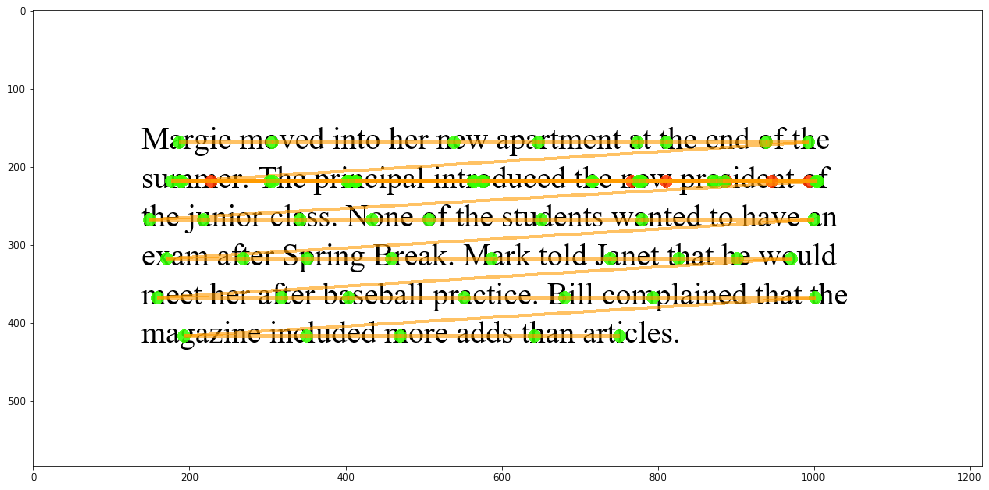

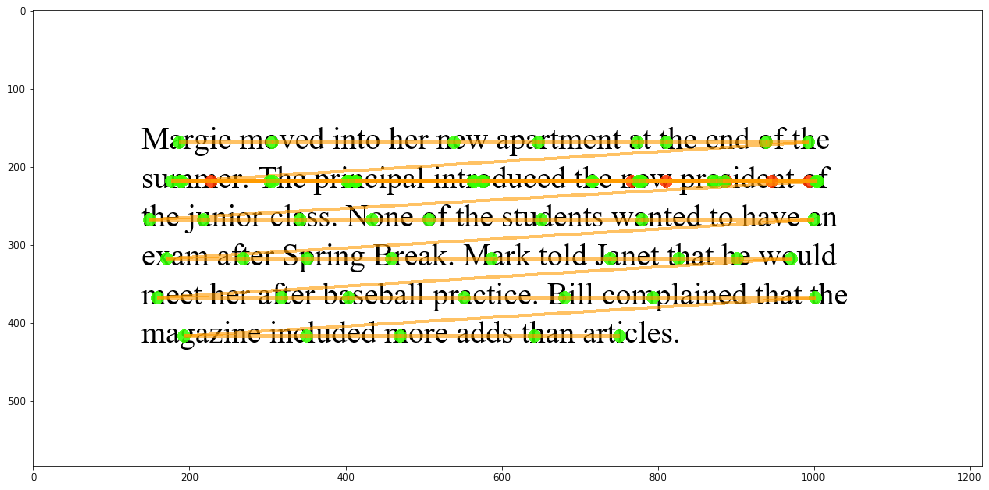

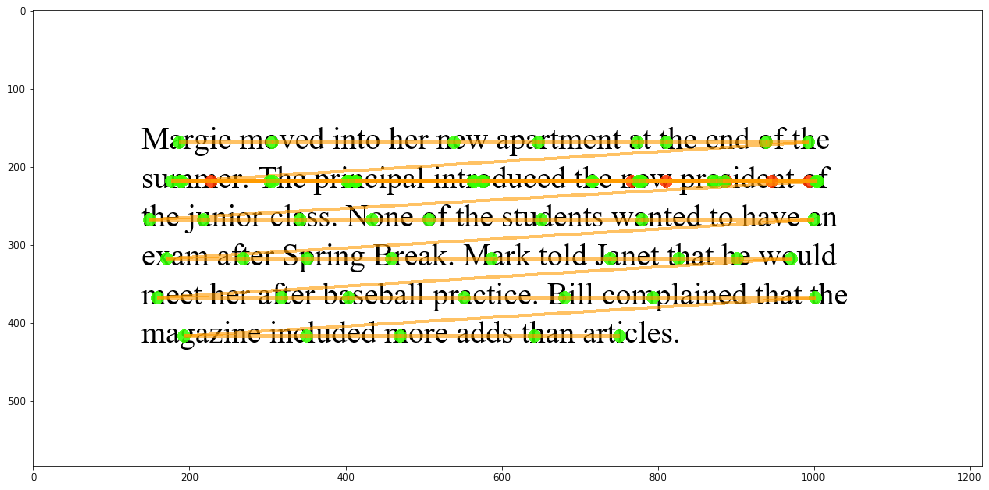

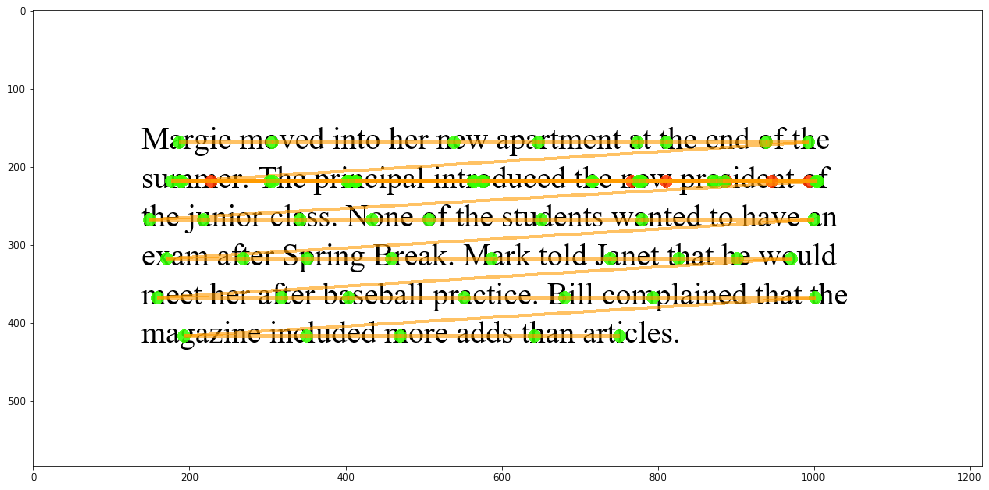

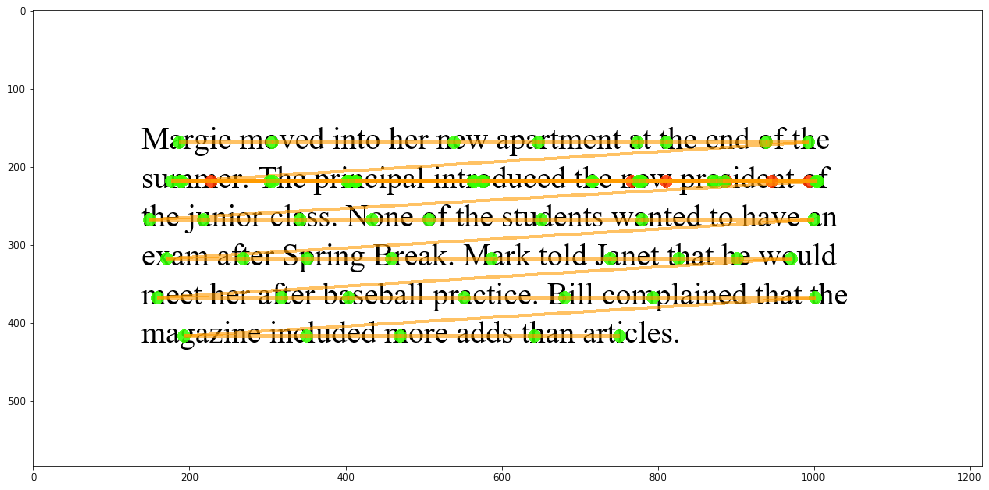

...

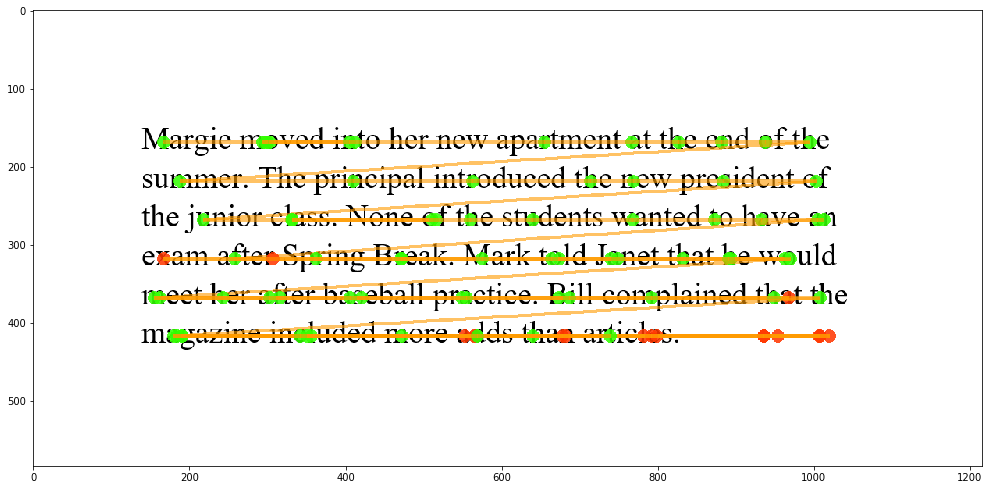

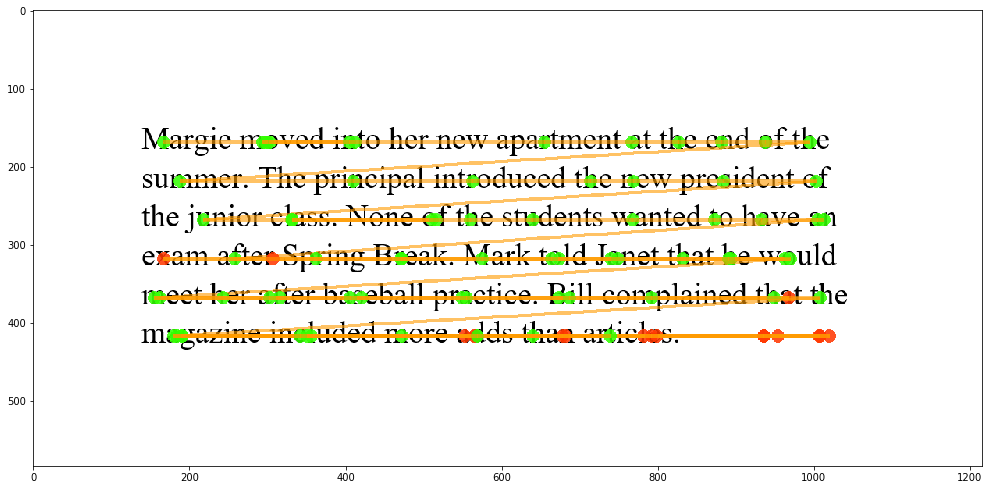

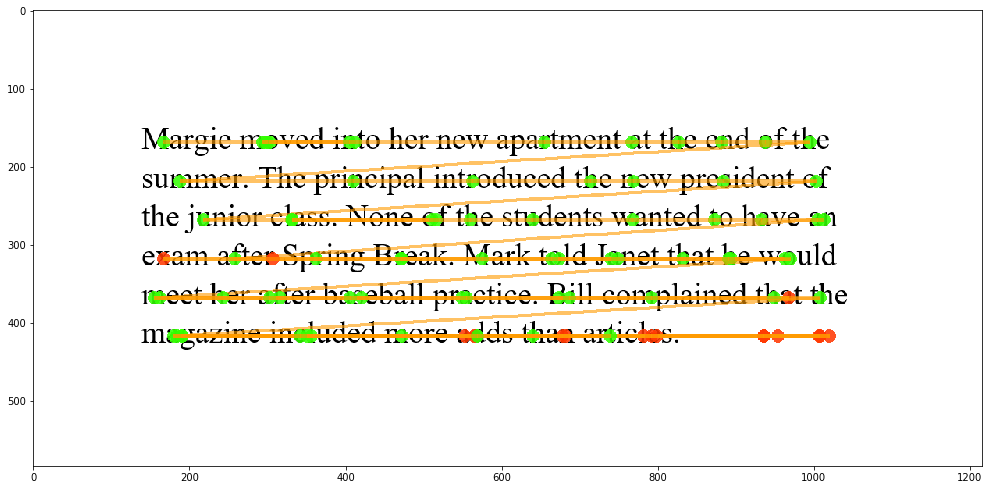

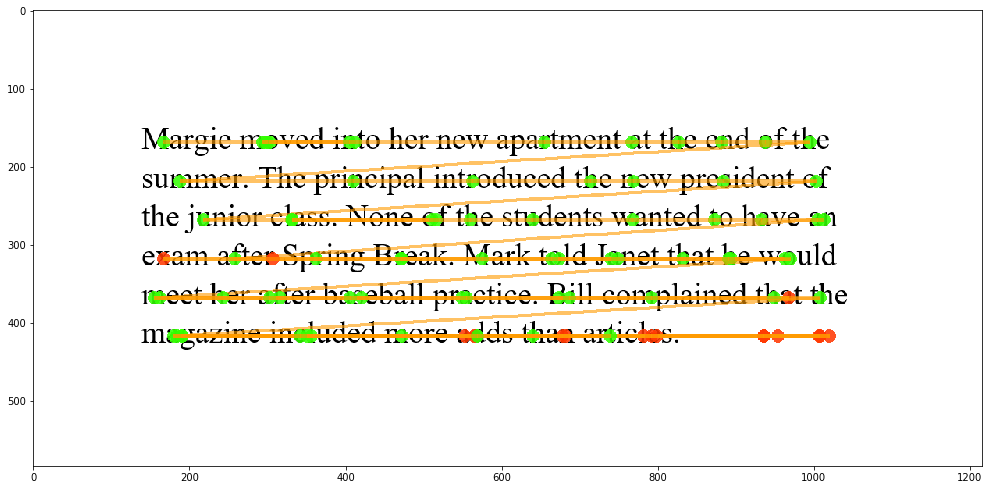

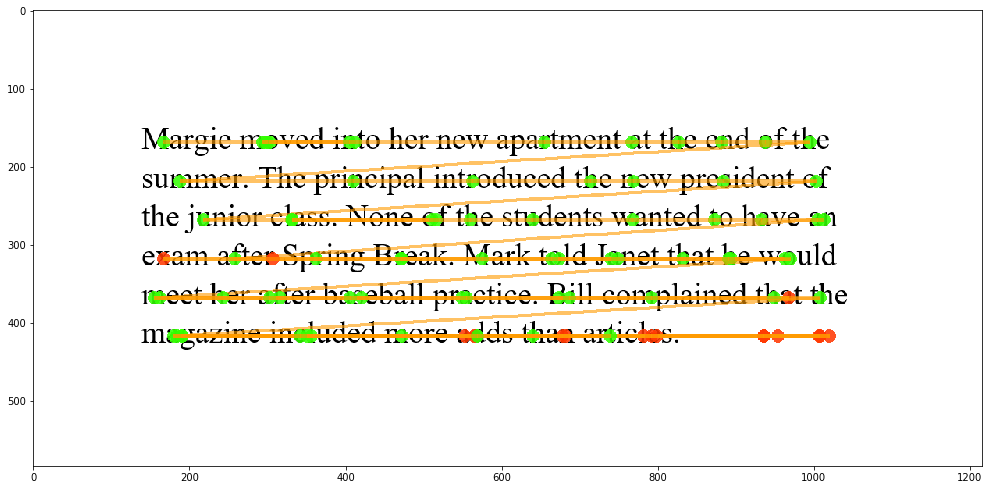

In [10]:


attach_results = [[],[],[],[],[],[],[],[],[],[],[]]
chain_results = [[],[],[],[],[],[],[],[],[],[],[]]
regress_results = [[],[],[],[],[],[],[],[],[],[],[]]
warp_results = [[],[],[],[],[],[],[],[],[],[],[]]

cluster_results = [[],[],[],[],[],[],[],[],[],[],[]]
compare_results = [[],[],[],[],[],[],[],[],[],[],[]]
merge_results = [[],[],[],[],[],[],[],[],[],[],[]]
segment_results = [[],[],[],[],[],[],[],[],[],[],[]]
split_results = [[],[],[],[],[],[],[],[],[],[],[]]
stretch_results = [[],[],[],[],[],[],[],[],[],[],[]]

word_centers = correction.find_word_centers(aoi)
word_centers = np.array(word_centers.copy(), dtype=int)

duration_word_centers = correction.find_word_centers_and_duration(aois_with_tokens)
duration_word_centers = np.array(duration_word_centers.copy(), dtype=int)

# MAKE SURE YOU RUN THIS 100 TIMES, NOT JUST ONE!!!
for robot_index in tqdm(range(100)):
    
    for error_probability in range(0, 11):
        # generate error
        error_test = correction.error_noise(error_probability/10, 30, error_probability/10, data['robot' + str(robot_index)].copy())

        # cluster correction
        np_array = np.array(error_test.copy())
        cluster_correction = algo.cluster(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), cluster_correction)
        cluster_results[error_probability].append(percentage)
        
        # compare correction
        np_array = np.array(error_test.copy())
        compare_correction = algo.compare(np_array, word_centers)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), compare_correction)
        compare_results[error_probability].append(percentage)
        
        # merge correction
        np_array = np.array(error_test.copy())
        merge_correction = algo.merge(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), merge_correction)
        merge_results[error_probability].append(percentage)
        
        # segment correction
        np_array = np.array(error_test.copy())
        segment_correction = algo.segment(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), segment_correction)
        segment_results[error_probability].append(percentage)
        
        # split correction
        np_array = np.array(error_test.copy())
        split_correction = algo.split(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), split_correction)
        split_results[error_probability].append(percentage)
        
        # stretch correction
        np_array = np.array(error_test.copy())
        stretch_correction = algo.stretch(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), stretch_correction)
        stretch_results[error_probability].append(percentage)
        
        # attach correction
        np_array = np.array(error_test.copy())
        attach_correction = algo.attach(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), attach_correction)
        attach_results[error_probability].append(percentage)

        # chain correction
        np_array = np.array(error_test.copy())
        chain_correction = algo.chain(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), chain_correction)
        chain_results[error_probability].append(percentage)
        
        # regress correction
        np_array = np.array(error_test.copy())
        regress_correction = algo.regress(np_array, line_ys)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), regress_correction)
        regress_results[error_probability].append(percentage)
        
        # warp correction
        np_array = np.array(error_test.copy(), dtype=int)
        durations = np.delete(np_array, 0, 1)
        durations = np.delete(durations, 0, 1)
        np_array = np.delete(np_array, 2, 1)
        
        warp_correction = algo.warp(np_array, word_centers)
        percentage, match_list = correction.correction_quality(aoi, data['robot' + str(robot_index)].copy(), warp_correction)
        warp_results[error_probability].append(percentage)

        if percentage < 1:
            correction.draw_correction('synthetic_text.png', warp_correction, match_list)
            print("robot:", robot_index, "    error probability:", error_probability)


In [11]:
import statistics

def mean_error_group(results):
    new_list = []
    
    for result in results:
        new_list.append(statistics.mean(result))
        
    return new_list

In [12]:
mean_attach_results = mean_error_group(attach_results)
mean_chain_results = mean_error_group(chain_results)
mean_regress_results = mean_error_group(regress_results)
mean_warp_results = mean_error_group(warp_results)

mean_cluster_results = mean_error_group(cluster_results)
mean_compare_results = mean_error_group(compare_results)
mean_segment_results = mean_error_group(segment_results)
mean_split_results = mean_error_group(split_results)
mean_stretch_results = mean_error_group(stretch_results)
mean_merge_results = mean_error_group(merge_results)

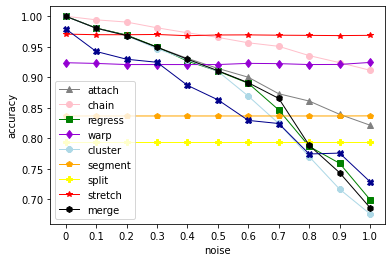

In [13]:
import matplotlib.pyplot as plt
plt.plot(mean_attach_results, color='Grey', linewidth=1, marker='^')
plt.plot(mean_chain_results, color='Pink', linewidth=1, marker='o')
plt.plot(mean_regress_results, color='Green', linewidth=1, marker='s')
plt.plot(mean_warp_results, color='DarkViolet', linewidth=1, marker='d')

plt.plot(mean_cluster_results, color='LightBlue', linewidth=1, marker='8')
plt.plot(mean_compare_results, color='Orange', linewidth=1, marker='p')
plt.plot(mean_segment_results, color='Yellow', linewidth=1, marker='P')
plt.plot(mean_split_results, color='Red', linewidth=1, marker='*')
plt.plot(mean_stretch_results, color='Black', linewidth=1, marker='h')
plt.plot(mean_merge_results, color='DarkBlue', linewidth=1, marker='X')

plt.legend(['attach', 'chain', 'regress', 'warp', 'cluster', 'segment', 'split', 'stretch', 'merge'])
plt.ylabel('accuracy')
plt.xlabel('noise')

x_ticks_labels = ['0', '0.1', '0.2', '0.3', '0.4', '0.5', '0.6', '0.7', '0.8', '0.9', '1.0']
plt.xticks(range(0, 11), x_ticks_labels)
plt.savefig("noise_comparison.png")
plt.show()

In [14]:
print("mean attach:", statistics.mean(mean_attach_results))
print("mean chain:", statistics.mean(mean_chain_results))
print("mean regress:", statistics.mean(mean_regress_results))
print("mean warp:", statistics.mean(mean_warp_results))

print("mean cluster:", statistics.mean(mean_warp_results))
print("mean compare:", statistics.mean(mean_compare_results))
print("mean segment:", statistics.mean(mean_warp_results))
print("mean split:", statistics.mean(mean_warp_results))
print("mean stretch:", statistics.mean(mean_warp_results))
print("mean merge:", statistics.mean(mean_warp_results))

mean attach: 0.9126419682678719
mean chain: 0.9619972123211701
mean regress: 0.883418499598411
mean warp: 0.9218999509068982
mean cluster: 0.9218999509068982
mean compare: 0.8365245629230591
mean segment: 0.9218999509068982
mean split: 0.9218999509068982
mean stretch: 0.9218999509068982
mean merge: 0.9218999509068982
